In [3]:
!mkdir -p ~/.kaggle

In [4]:
!kaggle datasets download -d mikhailma/house-rooms-streets-image-dataset

Dataset URL: https://www.kaggle.com/datasets/mikhailma/house-rooms-streets-image-dataset
License(s): CC0-1.0
house-rooms-streets-image-dataset.zip: Skipping, found more recently modified local copy (use --force to force download)


In [5]:
import zipfile
zip_ref = zipfile.ZipFile('/content/house-rooms-streets-image-dataset.zip', 'r')
zip_ref.extractall('/content/')
zip_ref.close()

In [6]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm  #  tqdm is a Python library for adding progress bar

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

In [7]:
BASE_DIR = '/content/kaggle_room_street_data/street_data'

In [8]:
# load complete image paths to the list
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [9]:
len(image_paths)

19658

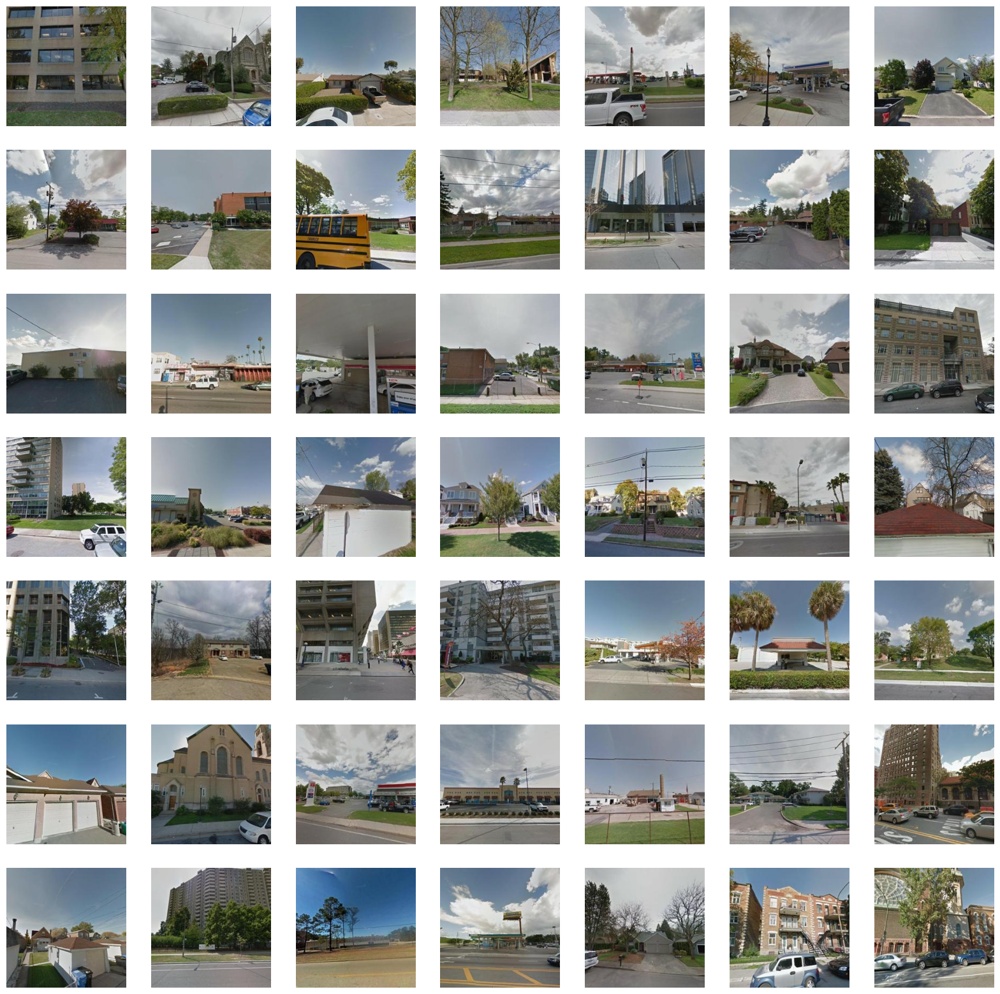

In [10]:
# to display grid of images (7x7)
plt.figure(figsize=(20, 20))
temp_images = image_paths[:49]
index = 1

for image_path in temp_images:
    plt.subplot(7, 7, index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the index for next image
    index += 1

In [11]:
from keras.preprocessing.image import load_img, img_to_array
# Define the target size for the images
target_size = (64, 64)

# Load and resize images, convert to numpy arrays
train_images = []
for path in tqdm(image_paths):
    img = load_img(path, target_size=target_size)
    img_array = img_to_array(img)
    train_images.append(img_array)

# Convert list of numpy arrays to a single numpy array
train_images = np.array(train_images)

  0%|          | 0/19658 [00:00<?, ?it/s]

In [12]:
train_images[0].shape

(64, 64, 3)

In [13]:
# reshape the array
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

In [14]:
# normalize the images
train_images = (train_images - 127.5) / 127.5

In [15]:
train_images[0]

array([[[ 0.05882353, -0.00392157, -0.18431373],
        [-0.12156863, -0.18431373, -0.27058825],
        [-0.16862746, -0.22352941, -0.27058825],
        ...,
        [-0.41960785, -0.37254903, -0.7176471 ],
        [-0.2627451 , -0.21568628, -0.49803922],
        [-0.49019608, -0.43529412, -0.6784314 ]],

       [[ 0.01176471, -0.05098039, -0.23137255],
        [-0.4509804 , -0.49803922, -0.5921569 ],
        [-0.7411765 , -0.77254903, -0.79607844],
        ...,
        [-0.24705882, -0.23921569, -0.49019608],
        [-0.43529412, -0.4117647 , -0.5764706 ],
        [ 0.01960784,  0.08235294, -0.03529412]],

       [[ 0.01176471, -0.05098039, -0.23137255],
        [-0.3882353 , -0.41960785, -0.49019608],
        [-0.7490196 , -0.7411765 , -0.7254902 ],
        ...,
        [-0.33333334, -0.34117648, -0.56078434],
        [-0.24705882, -0.22352941, -0.37254903],
        [-0.16078432, -0.13725491, -0.20784314]],

       ...,

       [[-0.54509807, -0.44313726, -0.6627451 ],
        [-0

In [16]:
# latent dimension for random noise
LATENT_DIM = 100
# weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# no. of channels of the image
CHANNELS = 3 # for gray scale, keep it as 1

In [17]:
model = Sequential(name='generator')

# 1d random noise
model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
model.add(layers.ReLU())

# convert 1d to 3d
model.add(layers.Reshape((8, 8, 512)))

# upsample to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.ReLU())

# upsample to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.ReLU())

# upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 32768)             3309568   
                                                                 
 re_lu (ReLU)                (None, 32768)             0         
                                                                 
 reshape (Reshape)           (None, 8, 8, 512)         0         
                                                                 
 conv2d_transpose (Conv2DTr  (None, 16, 16, 256)       2097408   
 anspose)                                                        
                                                                 
 re_lu_1 (ReLU)              (None, 16, 16, 256)       0         
                                                                 
 conv2d_transpose_1 (Conv2D  (None, 32, 32, 128)       524416    
 Transpose)                                              

In [18]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1 (Conv2D)           (None, 32, 32, 64)        3136      
                                                                 
 batch_normalization (Batch  (None, 32, 32, 64)        256       
 Normalization)                                                  
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 64)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 16, 16, 128)       131200    
                                                                 
 batch_normalization_1 (Bat  (None, 16, 16, 128)       512       
 chNormalization)                                                
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 16, 16, 128)     

In [19]:
#DCGAN

class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')
        self.d_accuracy_metric = keras.metrics.BinaryAccuracy(name='d_accuracy')
        self.g_accuracy_metric = keras.metrics.BinaryAccuracy(name='g_accuracy')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric, self.d_accuracy_metric, self.g_accuracy_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):
        batch_size = tf.shape(real_images)[0]
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))

        # Train discriminator
        with tf.GradientTape() as tape:
            pred_real = self.discriminator(real_images, training=True)
            real_labels = tf.ones((batch_size, 1)) * 0.9  # Smoothing for real labels
            d_loss_real = self.loss_fn(real_labels, pred_real)

            fake_images = self.generator(random_noise, training=True)
            pred_fake = self.discriminator(fake_images, training=True)
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)

            d_loss = (d_loss_real + d_loss_fake) / 2

            d_accuracy = self.d_accuracy_metric.update_state(tf.concat([tf.ones_like(pred_real), tf.zeros_like(pred_fake)], axis=0),
                                                             tf.concat([pred_real, pred_fake], axis=0))

        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))

        # Train generator
        with tf.GradientTape() as tape:
            fake_images = self.generator(random_noise, training=True)
            pred_fake = self.discriminator(fake_images, training=True)
            labels = tf.ones((batch_size, 1))
            g_loss = self.loss_fn(labels, pred_fake)

            g_accuracy = self.g_accuracy_metric.update_state(tf.ones_like(pred_fake), pred_fake)

        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))

        # Update metrics
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(),
                'g_loss': self.g_loss_metric.result(),
                'd_accuracy': self.d_accuracy_metric.result(),
                'g_accuracy': self.g_accuracy_metric.result()}


In [20]:
# we will plot some images for each epoch

class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100, output_dir='/content/drive/MyDrive/outputs'):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        self.output_dir = output_dir
        os.makedirs(self.output_dir, exist_ok=True)
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()

        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        file_path = os.path.join(self.output_dir, 'epoch_{:03d}.png'.format(epoch))
        plt.savefig(file_path)
        plt.show()

    def on_train_end(self, logs=None):
        model_path = os.path.join(self.output_dir, 'generator.h5')
        self.model.generator.save(model_path)

In [21]:
# initialize the DCGAN model
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [22]:
# compile the DCGAN model
D_LR = 0.0001
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/50
615/615 [==============================] - ETA: 0s - d_loss: 1.0310 - g_loss: 2.5549 - d_accuracy: 0.6783 - g_accuracy: 0.1313

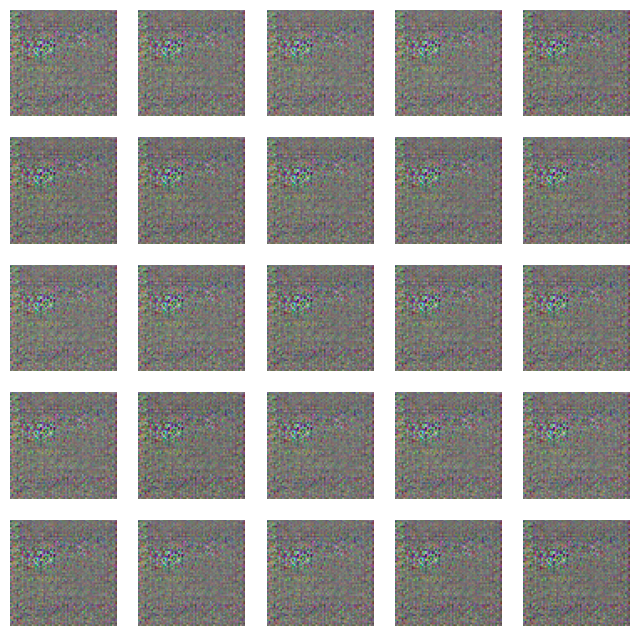

615/615 [==============================] - 53s 68ms/step - d_loss: 1.0310 - g_loss: 2.5549 - d_accuracy: 0.6783 - g_accuracy: 0.1313
Epoch 2/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.5337 - g_loss: 1.9621 - d_accuracy: 0.7576 - g_accuracy: 0.0787

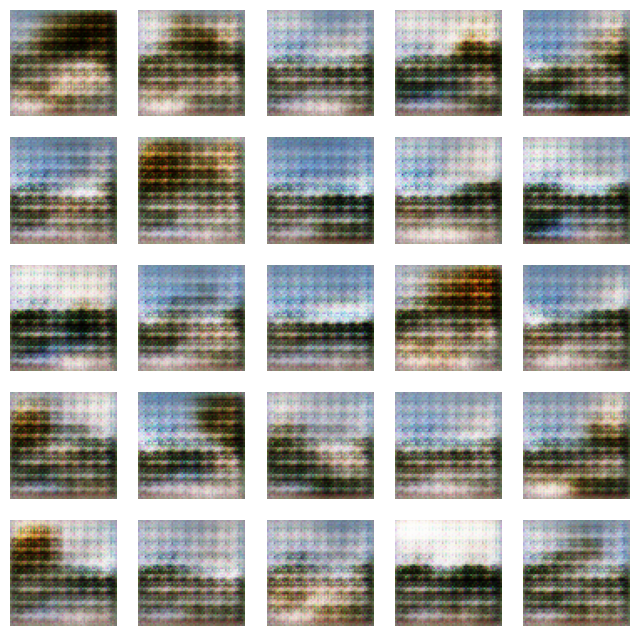

615/615 [==============================] - 42s 68ms/step - d_loss: 0.5337 - g_loss: 1.9615 - d_accuracy: 0.7576 - g_accuracy: 0.0788
Epoch 3/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.5724 - g_loss: 1.5362 - d_accuracy: 0.7215 - g_accuracy: 0.0694

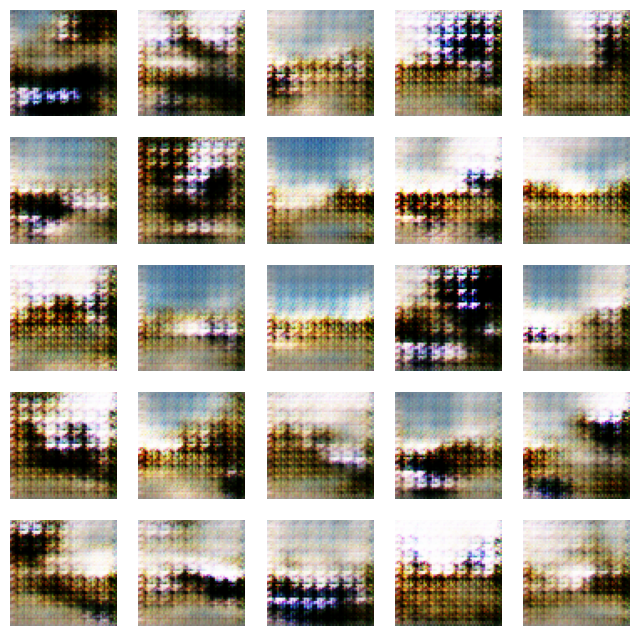

615/615 [==============================] - 41s 67ms/step - d_loss: 0.5723 - g_loss: 1.5365 - d_accuracy: 0.7216 - g_accuracy: 0.0694
Epoch 4/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.5672 - g_loss: 1.7177 - d_accuracy: 0.7255 - g_accuracy: 0.0544

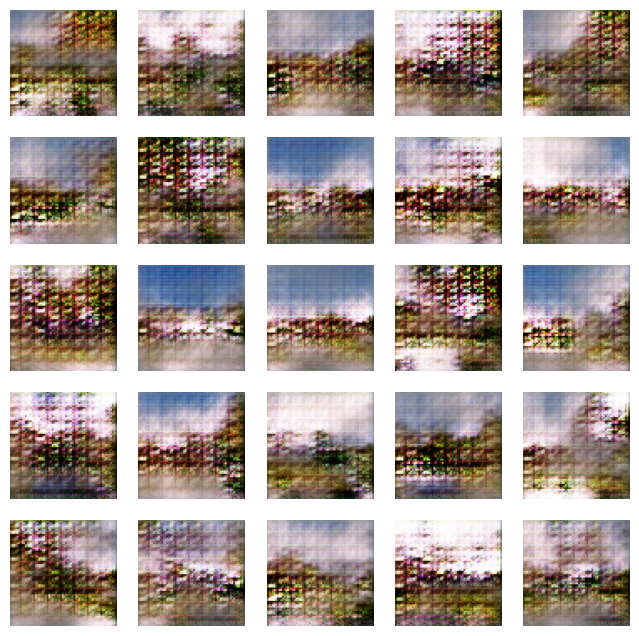

615/615 [==============================] - 42s 69ms/step - d_loss: 0.5672 - g_loss: 1.7173 - d_accuracy: 0.7255 - g_accuracy: 0.0543
Epoch 5/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6432 - g_loss: 1.4622 - d_accuracy: 0.6439 - g_accuracy: 0.0932

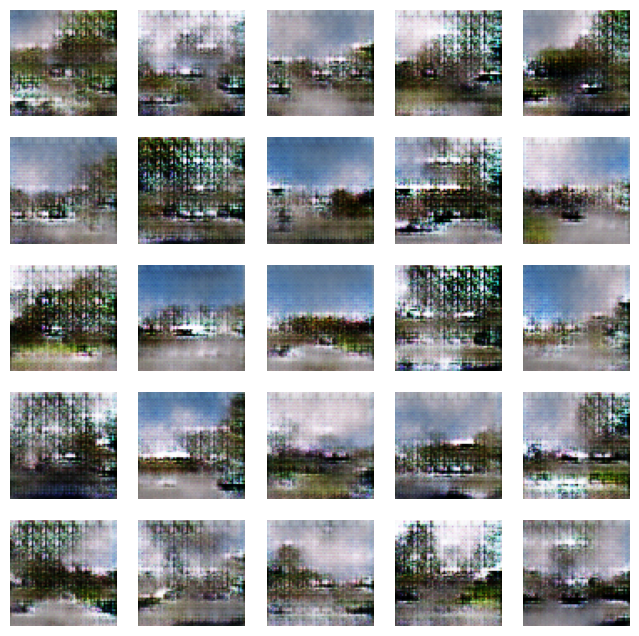

615/615 [==============================] - 42s 68ms/step - d_loss: 0.6433 - g_loss: 1.4622 - d_accuracy: 0.6439 - g_accuracy: 0.0932
Epoch 6/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6669 - g_loss: 1.3280 - d_accuracy: 0.6145 - g_accuracy: 0.1113

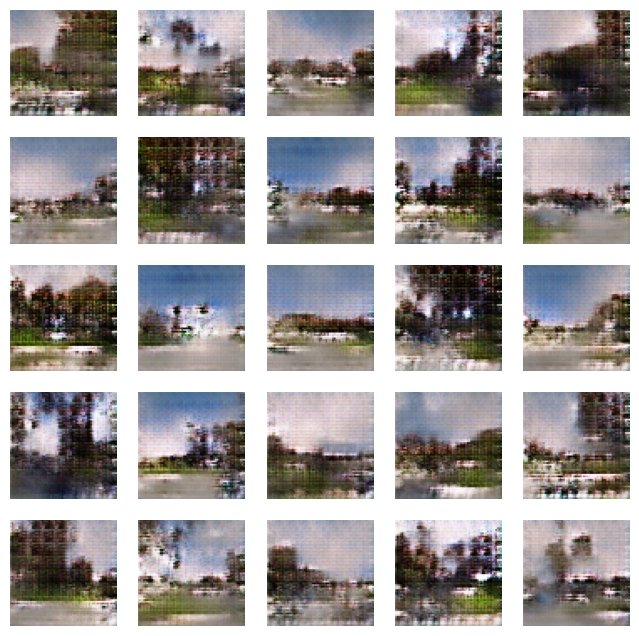

615/615 [==============================] - 42s 69ms/step - d_loss: 0.6670 - g_loss: 1.3280 - d_accuracy: 0.6145 - g_accuracy: 0.1113
Epoch 7/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6671 - g_loss: 1.2793 - d_accuracy: 0.6107 - g_accuracy: 0.1162

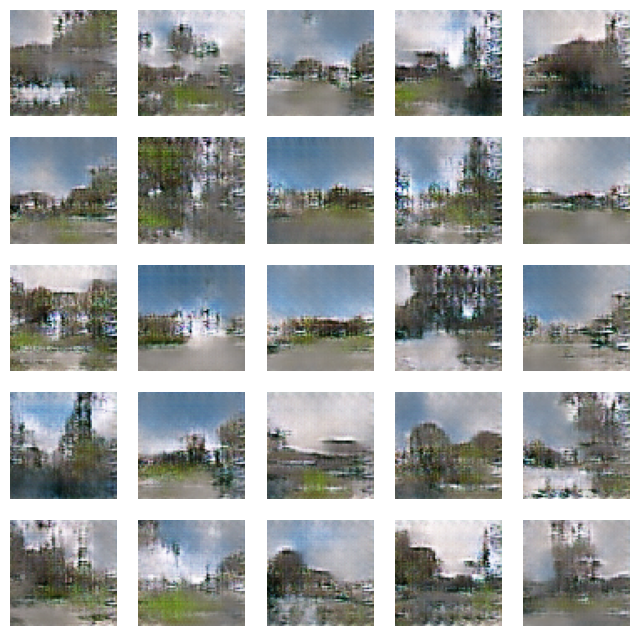

615/615 [==============================] - 42s 69ms/step - d_loss: 0.6668 - g_loss: 1.2796 - d_accuracy: 0.6108 - g_accuracy: 0.1161
Epoch 8/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6704 - g_loss: 1.2259 - d_accuracy: 0.6034 - g_accuracy: 0.1237

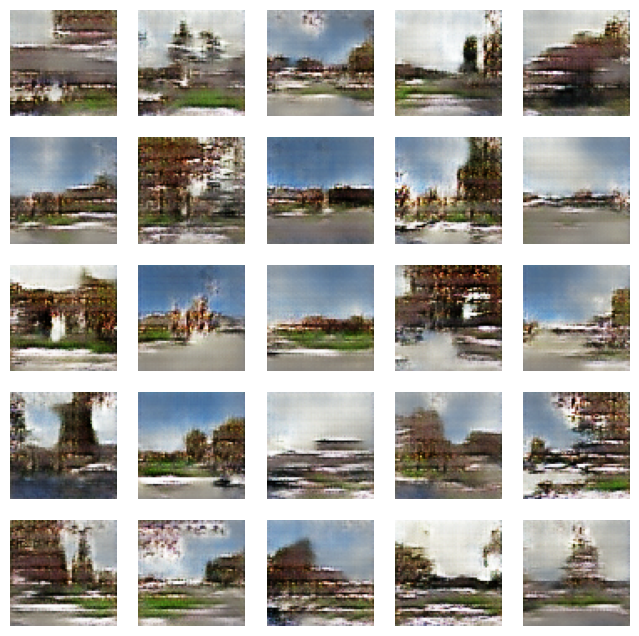

615/615 [==============================] - 42s 69ms/step - d_loss: 0.6705 - g_loss: 1.2260 - d_accuracy: 0.6033 - g_accuracy: 0.1237
Epoch 9/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6865 - g_loss: 1.1291 - d_accuracy: 0.5772 - g_accuracy: 0.1510

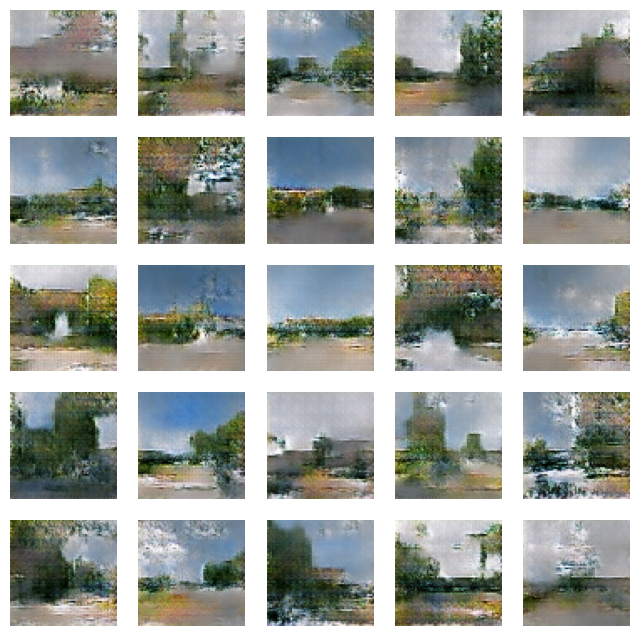

615/615 [==============================] - 43s 69ms/step - d_loss: 0.6866 - g_loss: 1.1285 - d_accuracy: 0.5772 - g_accuracy: 0.1511
Epoch 10/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6955 - g_loss: 1.0595 - d_accuracy: 0.5610 - g_accuracy: 0.1728

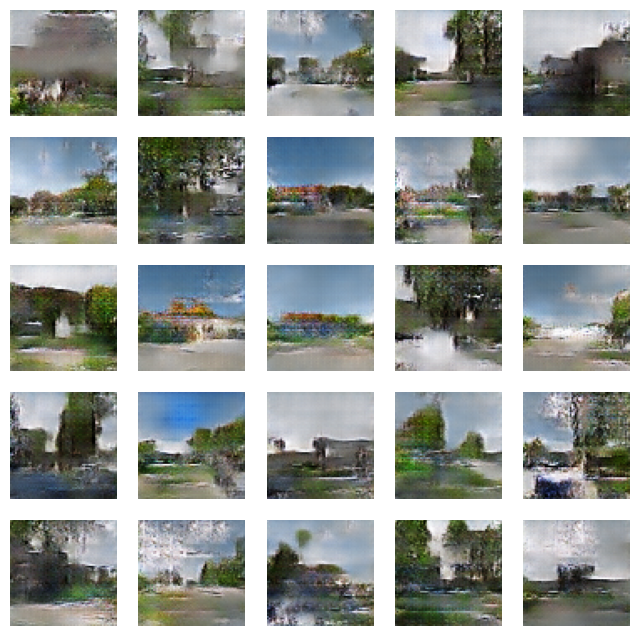

615/615 [==============================] - 43s 69ms/step - d_loss: 0.6954 - g_loss: 1.0600 - d_accuracy: 0.5610 - g_accuracy: 0.1728
Epoch 11/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.7061 - g_loss: 0.9796 - d_accuracy: 0.5311 - g_accuracy: 0.1930

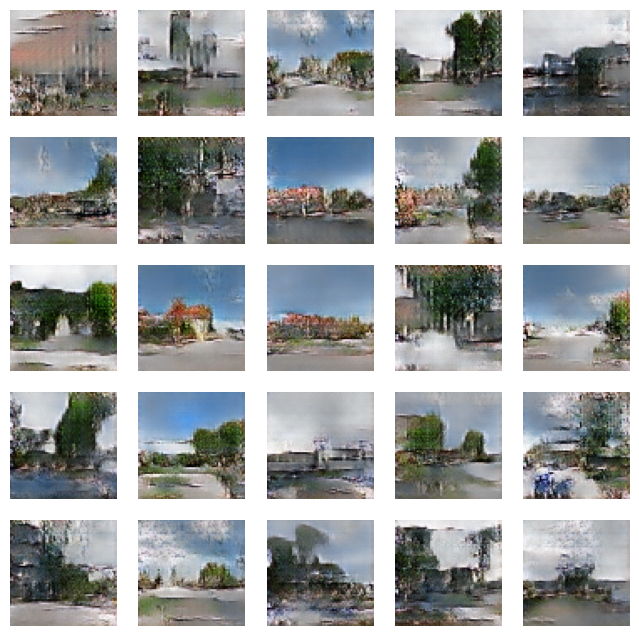

615/615 [==============================] - 42s 69ms/step - d_loss: 0.7060 - g_loss: 0.9795 - d_accuracy: 0.5311 - g_accuracy: 0.1931
Epoch 12/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.7044 - g_loss: 0.9400 - d_accuracy: 0.5238 - g_accuracy: 0.1944

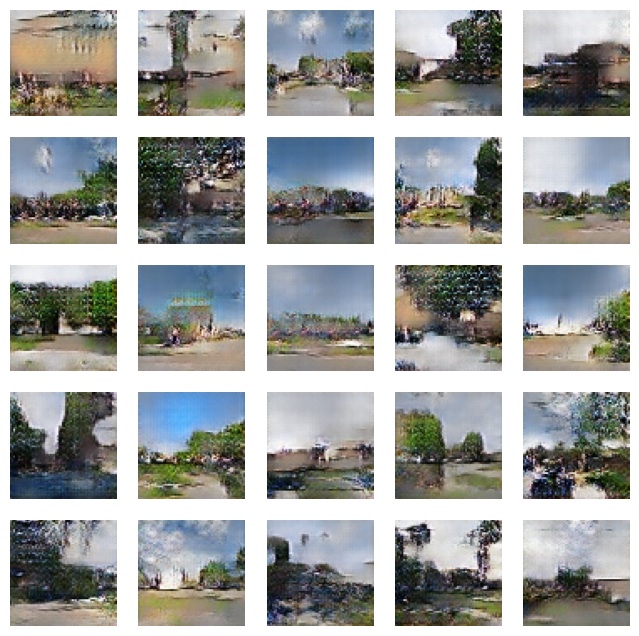

615/615 [==============================] - 43s 69ms/step - d_loss: 0.7044 - g_loss: 0.9399 - d_accuracy: 0.5239 - g_accuracy: 0.1945
Epoch 13/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.7057 - g_loss: 0.9127 - d_accuracy: 0.5138 - g_accuracy: 0.1982

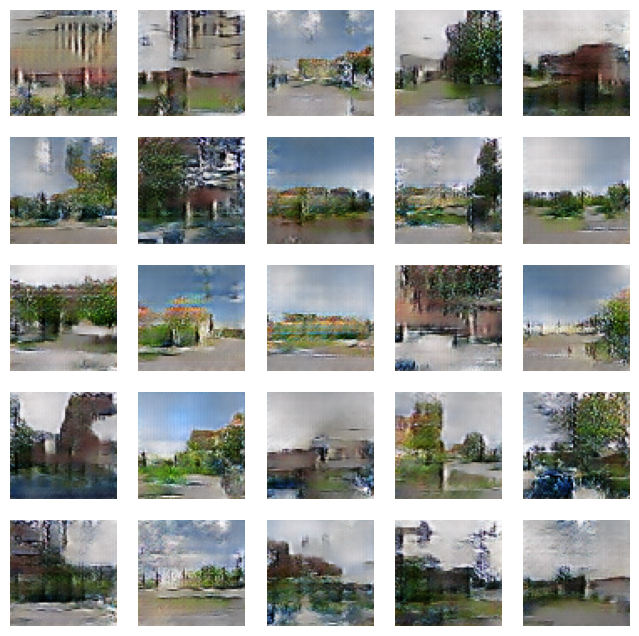

615/615 [==============================] - 42s 69ms/step - d_loss: 0.7058 - g_loss: 0.9128 - d_accuracy: 0.5137 - g_accuracy: 0.1981
Epoch 14/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.7037 - g_loss: 0.8931 - d_accuracy: 0.5129 - g_accuracy: 0.1858

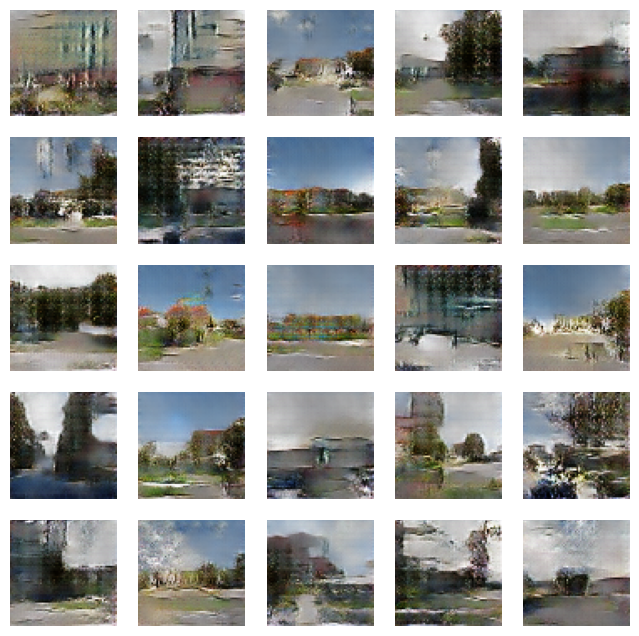

615/615 [==============================] - 42s 69ms/step - d_loss: 0.7038 - g_loss: 0.8931 - d_accuracy: 0.5128 - g_accuracy: 0.1858
Epoch 15/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.7034 - g_loss: 0.8835 - d_accuracy: 0.5056 - g_accuracy: 0.1832

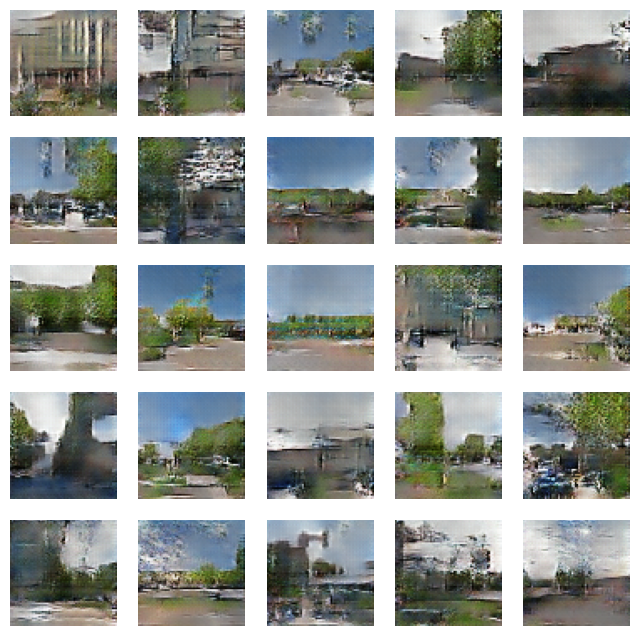

615/615 [==============================] - 43s 70ms/step - d_loss: 0.7033 - g_loss: 0.8838 - d_accuracy: 0.5056 - g_accuracy: 0.1831
Epoch 16/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.7015 - g_loss: 0.8759 - d_accuracy: 0.5041 - g_accuracy: 0.1718

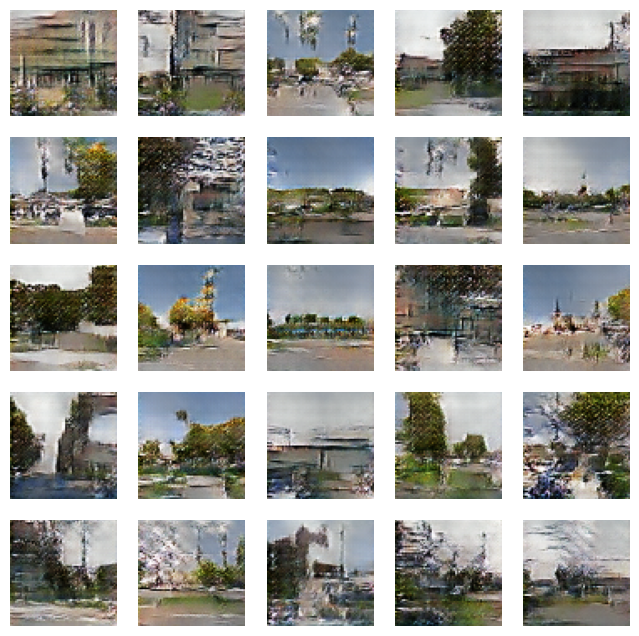

615/615 [==============================] - 43s 69ms/step - d_loss: 0.7015 - g_loss: 0.8759 - d_accuracy: 0.5040 - g_accuracy: 0.1719
Epoch 17/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.7007 - g_loss: 0.8663 - d_accuracy: 0.5013 - g_accuracy: 0.1627

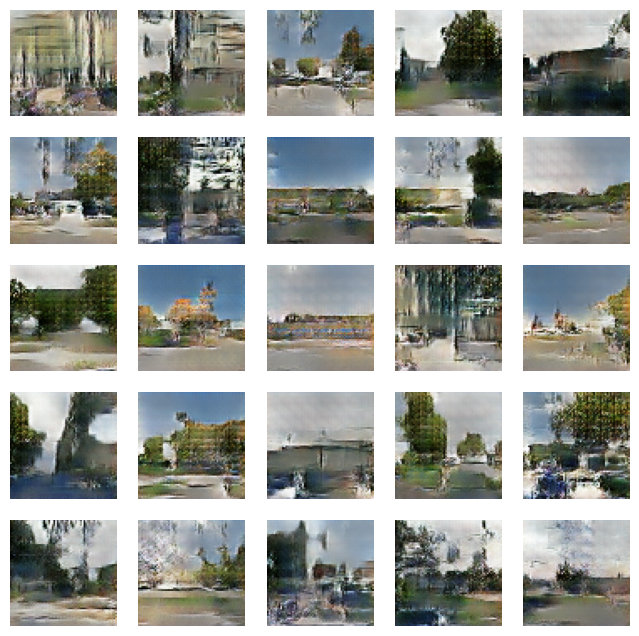

615/615 [==============================] - 42s 69ms/step - d_loss: 0.7007 - g_loss: 0.8663 - d_accuracy: 0.5013 - g_accuracy: 0.1627
Epoch 18/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.7004 - g_loss: 0.8634 - d_accuracy: 0.5012 - g_accuracy: 0.1528

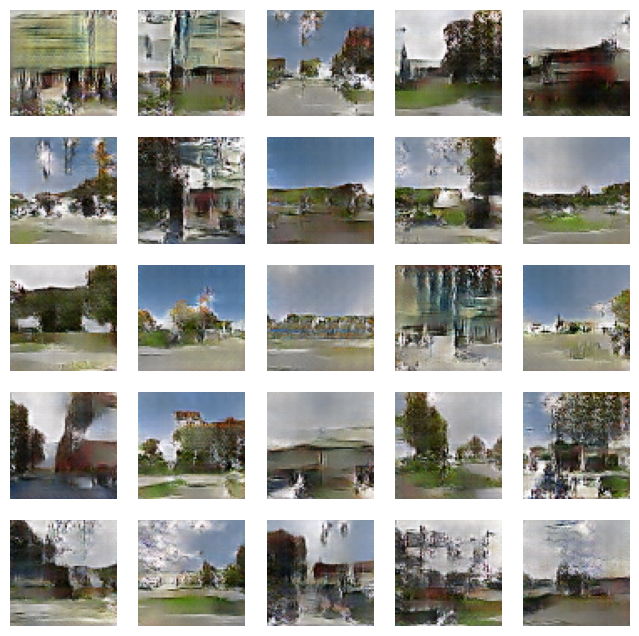

615/615 [==============================] - 43s 69ms/step - d_loss: 0.7005 - g_loss: 0.8633 - d_accuracy: 0.5011 - g_accuracy: 0.1529
Epoch 19/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6979 - g_loss: 0.8599 - d_accuracy: 0.5033 - g_accuracy: 0.1431

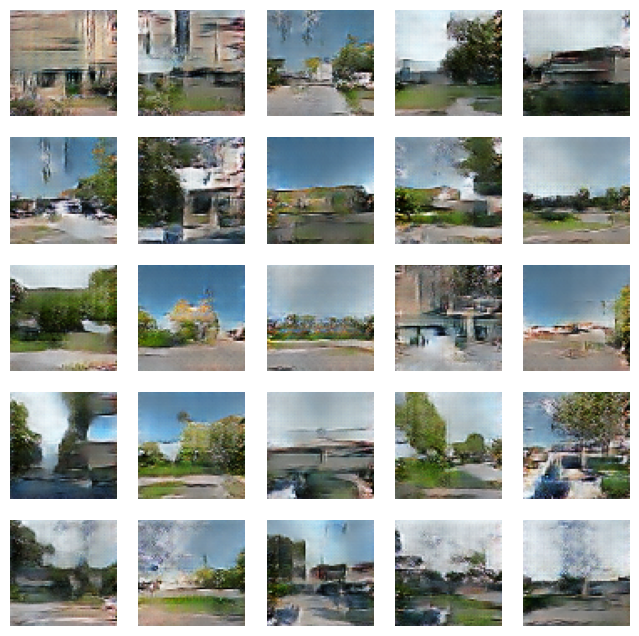

615/615 [==============================] - 42s 68ms/step - d_loss: 0.6979 - g_loss: 0.8602 - d_accuracy: 0.5034 - g_accuracy: 0.1430
Epoch 20/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6981 - g_loss: 0.8606 - d_accuracy: 0.5042 - g_accuracy: 0.1358

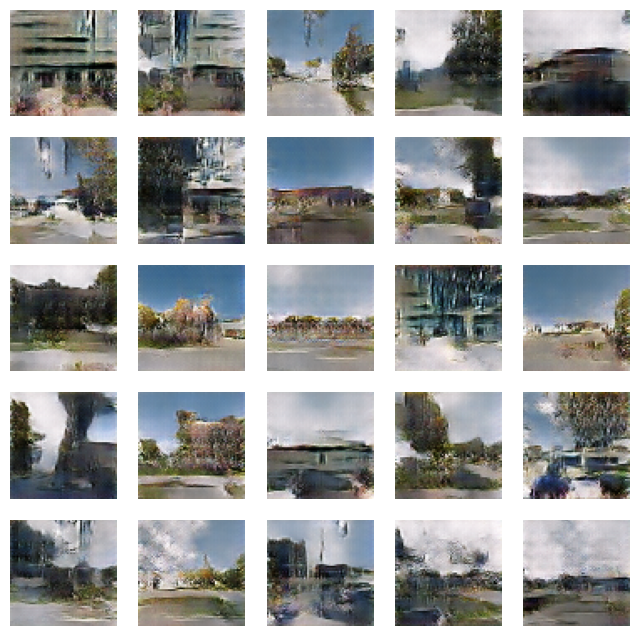

615/615 [==============================] - 42s 69ms/step - d_loss: 0.6981 - g_loss: 0.8605 - d_accuracy: 0.5042 - g_accuracy: 0.1359
Epoch 21/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6958 - g_loss: 0.8567 - d_accuracy: 0.5059 - g_accuracy: 0.1331

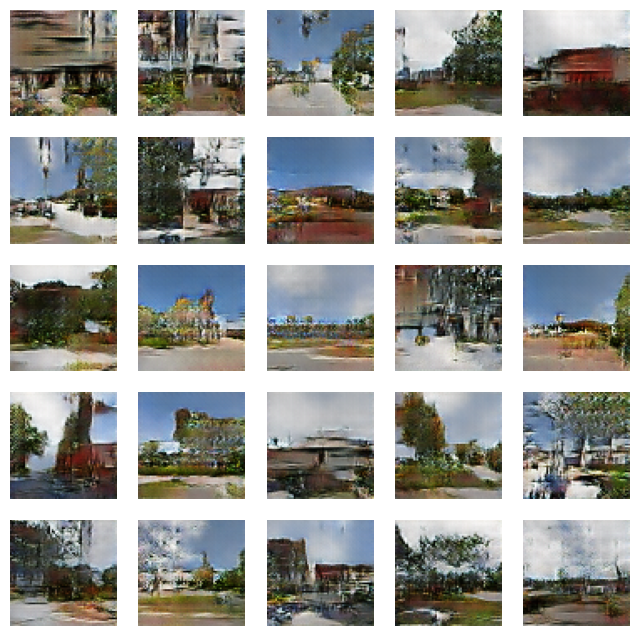

615/615 [==============================] - 43s 70ms/step - d_loss: 0.6958 - g_loss: 0.8567 - d_accuracy: 0.5059 - g_accuracy: 0.1331
Epoch 22/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6952 - g_loss: 0.8582 - d_accuracy: 0.5071 - g_accuracy: 0.1237

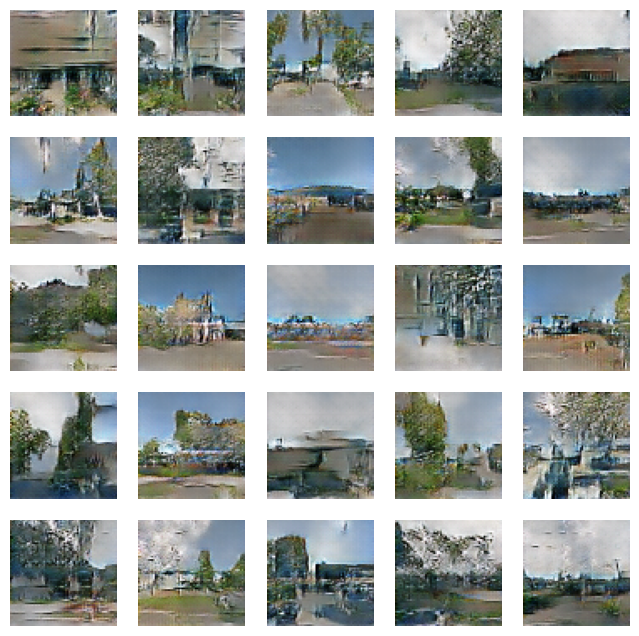

615/615 [==============================] - 42s 69ms/step - d_loss: 0.6951 - g_loss: 0.8583 - d_accuracy: 0.5072 - g_accuracy: 0.1236
Epoch 23/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6934 - g_loss: 0.8623 - d_accuracy: 0.5119 - g_accuracy: 0.1178

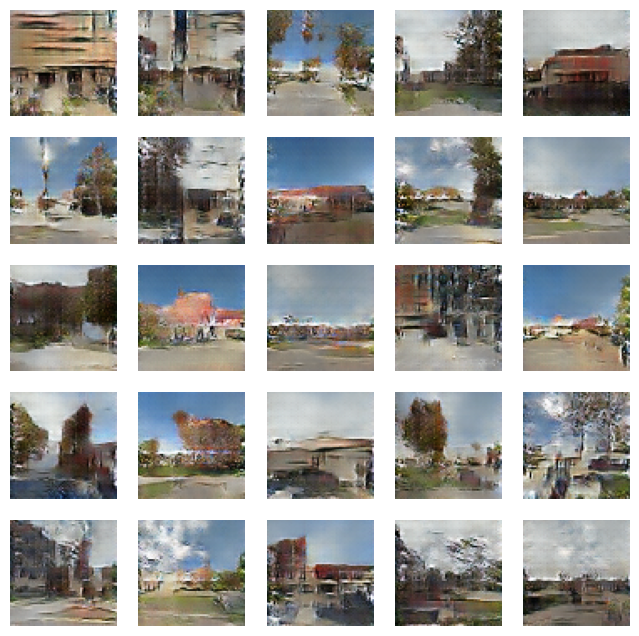

615/615 [==============================] - 42s 69ms/step - d_loss: 0.6933 - g_loss: 0.8624 - d_accuracy: 0.5120 - g_accuracy: 0.1177
Epoch 24/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6914 - g_loss: 0.8613 - d_accuracy: 0.5179 - g_accuracy: 0.1210

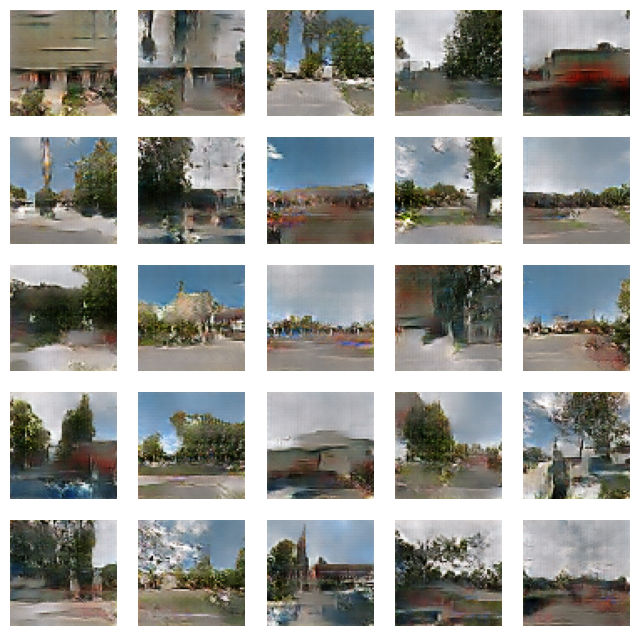

615/615 [==============================] - 42s 69ms/step - d_loss: 0.6914 - g_loss: 0.8614 - d_accuracy: 0.5179 - g_accuracy: 0.1209
Epoch 25/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6925 - g_loss: 0.8635 - d_accuracy: 0.5141 - g_accuracy: 0.1159

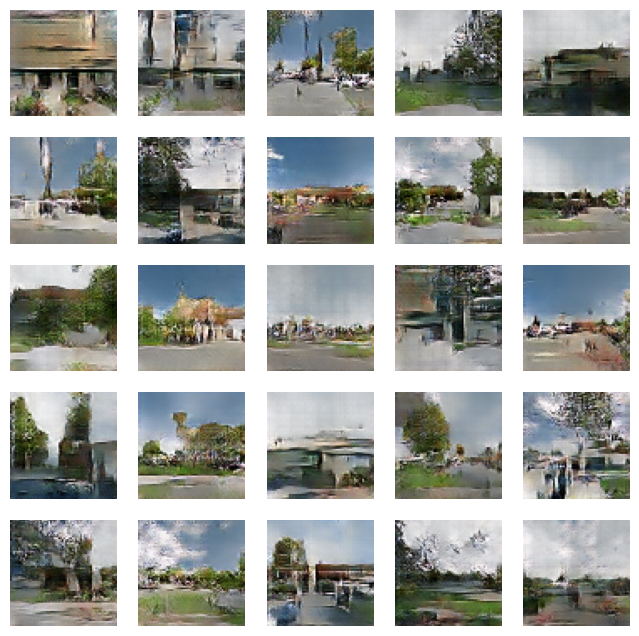

615/615 [==============================] - 42s 69ms/step - d_loss: 0.6926 - g_loss: 0.8635 - d_accuracy: 0.5141 - g_accuracy: 0.1159
Epoch 26/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6894 - g_loss: 0.8710 - d_accuracy: 0.5214 - g_accuracy: 0.1126

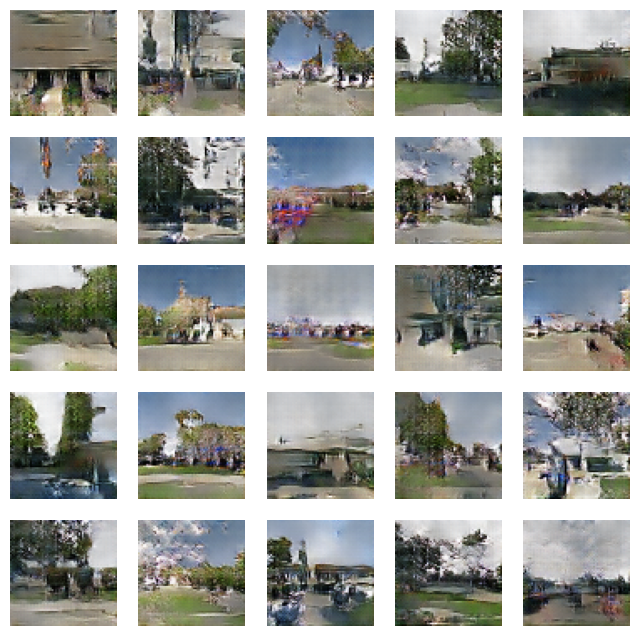

615/615 [==============================] - 42s 68ms/step - d_loss: 0.6893 - g_loss: 0.8710 - d_accuracy: 0.5214 - g_accuracy: 0.1126
Epoch 27/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6875 - g_loss: 0.8747 - d_accuracy: 0.5260 - g_accuracy: 0.1107

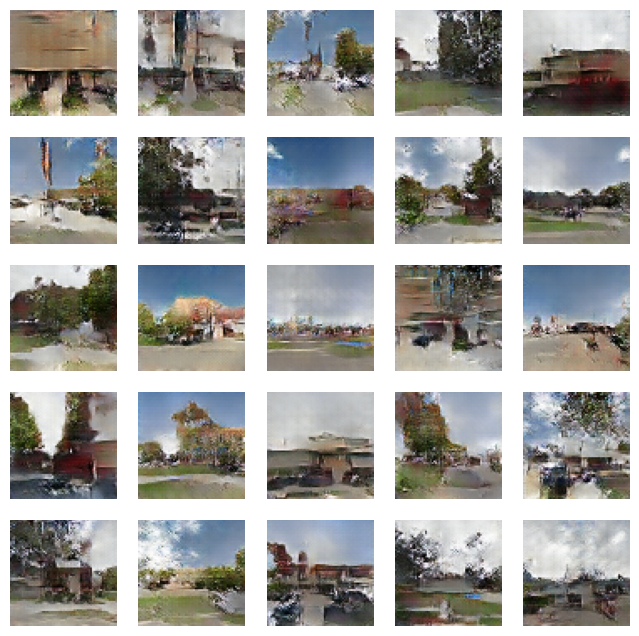

615/615 [==============================] - 42s 68ms/step - d_loss: 0.6875 - g_loss: 0.8747 - d_accuracy: 0.5259 - g_accuracy: 0.1107
Epoch 28/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6871 - g_loss: 0.8798 - d_accuracy: 0.5299 - g_accuracy: 0.1166

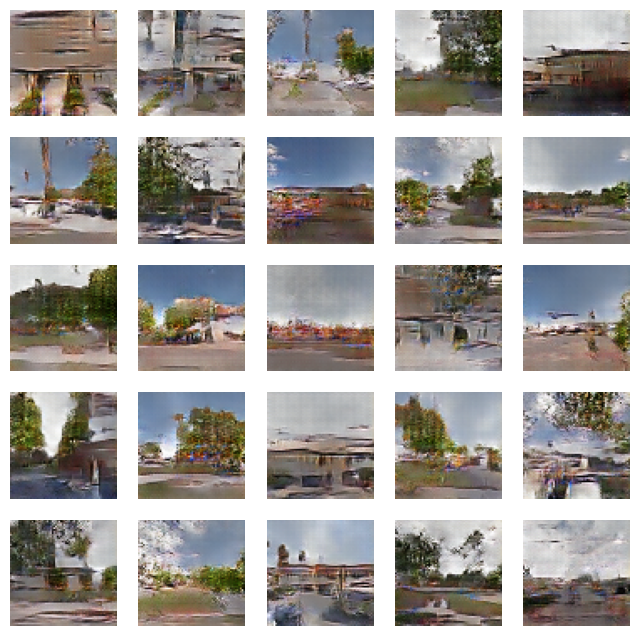

615/615 [==============================] - 43s 70ms/step - d_loss: 0.6871 - g_loss: 0.8799 - d_accuracy: 0.5298 - g_accuracy: 0.1165
Epoch 29/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6848 - g_loss: 0.8835 - d_accuracy: 0.5339 - g_accuracy: 0.1122

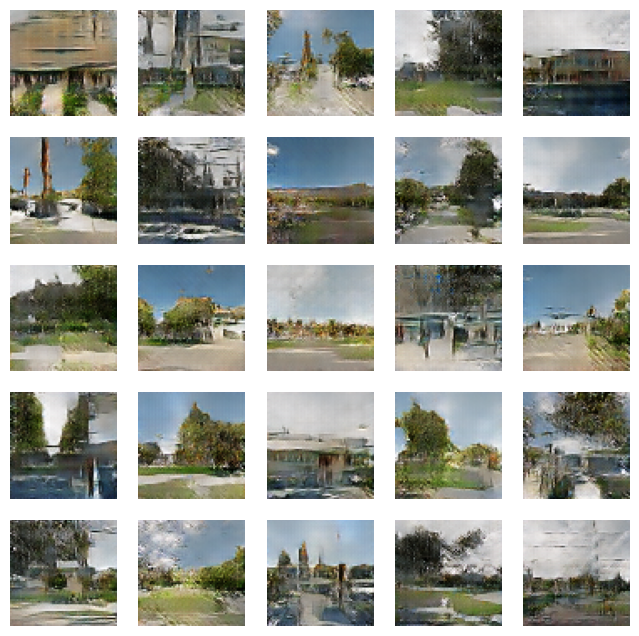

615/615 [==============================] - 42s 69ms/step - d_loss: 0.6848 - g_loss: 0.8836 - d_accuracy: 0.5339 - g_accuracy: 0.1122
Epoch 30/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6835 - g_loss: 0.8941 - d_accuracy: 0.5399 - g_accuracy: 0.1137

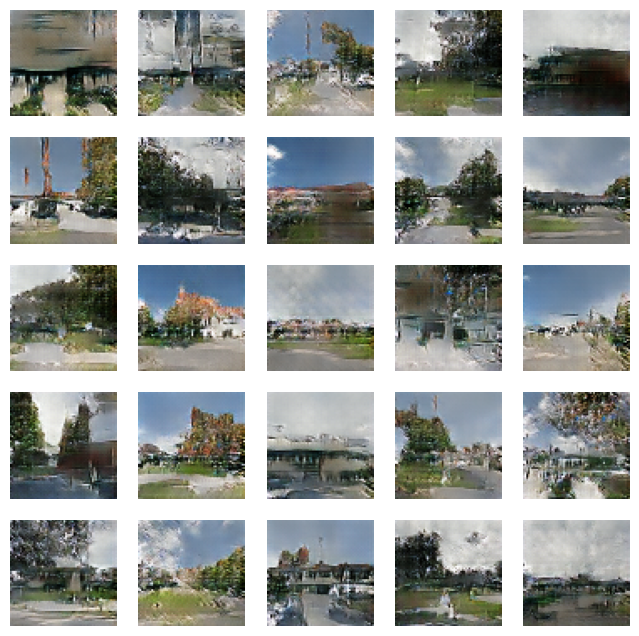

615/615 [==============================] - 43s 69ms/step - d_loss: 0.6835 - g_loss: 0.8941 - d_accuracy: 0.5399 - g_accuracy: 0.1136
Epoch 31/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6821 - g_loss: 0.8979 - d_accuracy: 0.5446 - g_accuracy: 0.1139

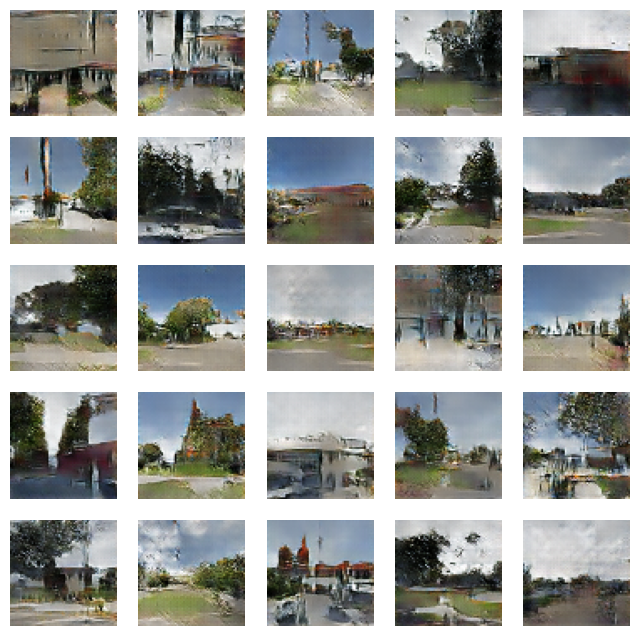

615/615 [==============================] - 42s 69ms/step - d_loss: 0.6820 - g_loss: 0.8981 - d_accuracy: 0.5446 - g_accuracy: 0.1138
Epoch 32/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6802 - g_loss: 0.9038 - d_accuracy: 0.5481 - g_accuracy: 0.1168

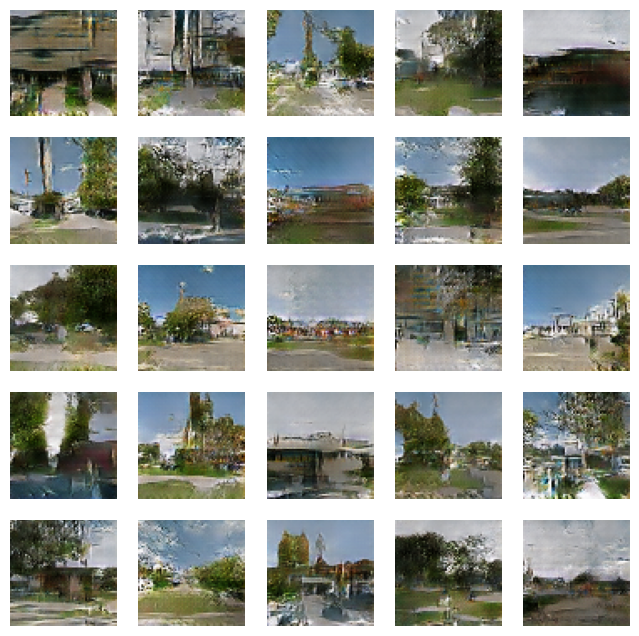

615/615 [==============================] - 42s 68ms/step - d_loss: 0.6803 - g_loss: 0.9039 - d_accuracy: 0.5481 - g_accuracy: 0.1168
Epoch 33/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6780 - g_loss: 0.9097 - d_accuracy: 0.5545 - g_accuracy: 0.1160

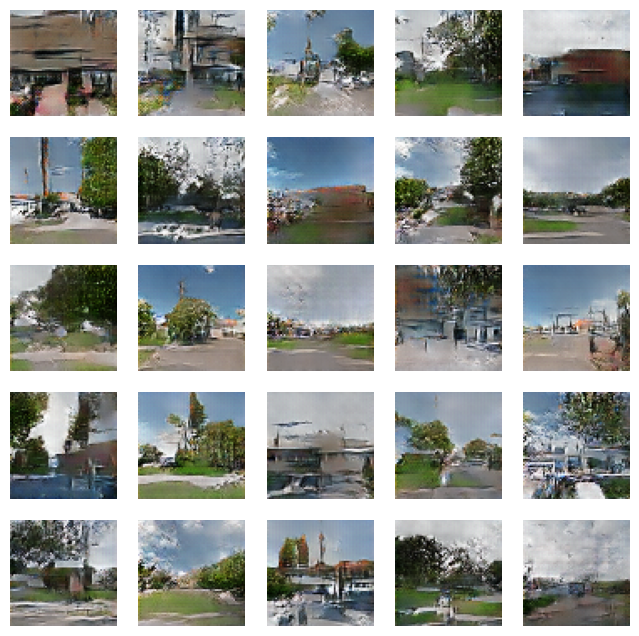

615/615 [==============================] - 42s 69ms/step - d_loss: 0.6780 - g_loss: 0.9097 - d_accuracy: 0.5546 - g_accuracy: 0.1161
Epoch 34/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6740 - g_loss: 0.9177 - d_accuracy: 0.5631 - g_accuracy: 0.1197

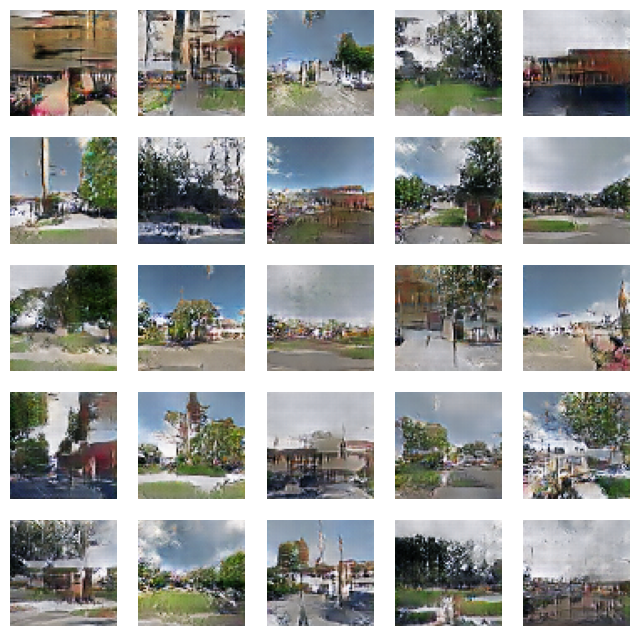

615/615 [==============================] - 42s 68ms/step - d_loss: 0.6740 - g_loss: 0.9176 - d_accuracy: 0.5631 - g_accuracy: 0.1198
Epoch 35/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6729 - g_loss: 0.9336 - d_accuracy: 0.5655 - g_accuracy: 0.1194

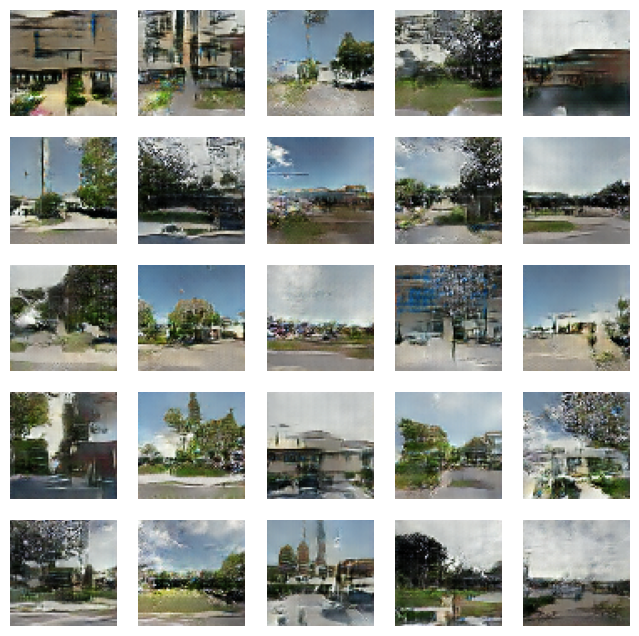

615/615 [==============================] - 42s 69ms/step - d_loss: 0.6729 - g_loss: 0.9337 - d_accuracy: 0.5655 - g_accuracy: 0.1193
Epoch 36/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6701 - g_loss: 0.9380 - d_accuracy: 0.5710 - g_accuracy: 0.1192

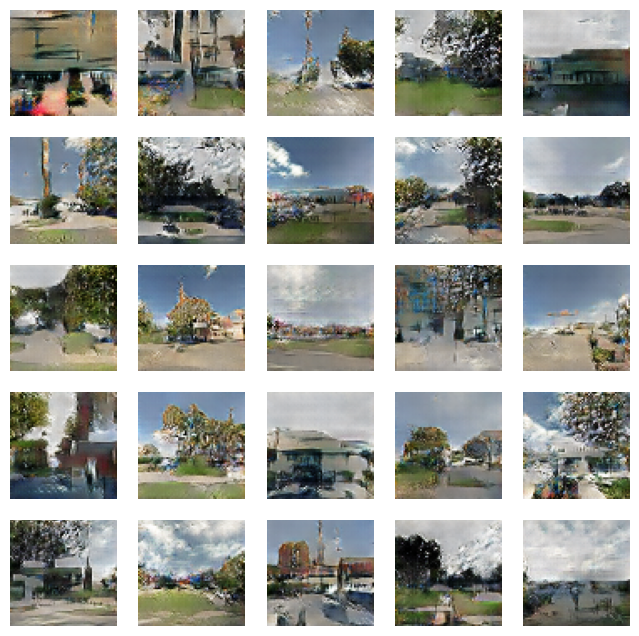

615/615 [==============================] - 42s 69ms/step - d_loss: 0.6701 - g_loss: 0.9383 - d_accuracy: 0.5709 - g_accuracy: 0.1191
Epoch 37/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6655 - g_loss: 0.9517 - d_accuracy: 0.5842 - g_accuracy: 0.1203

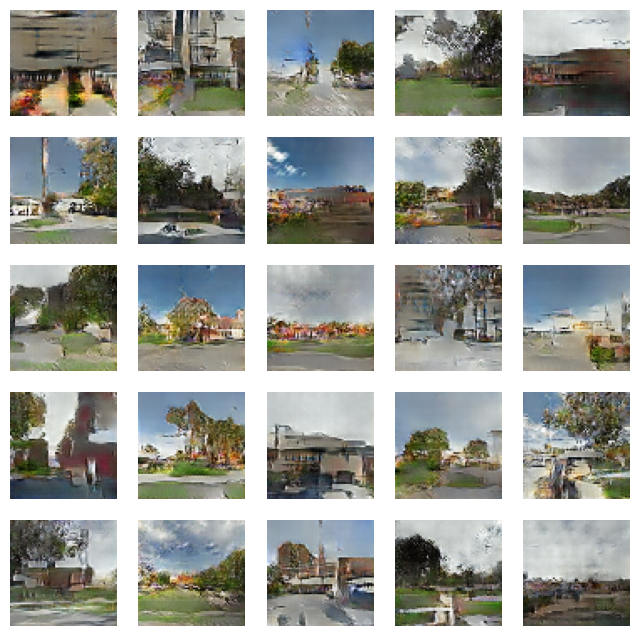

615/615 [==============================] - 42s 68ms/step - d_loss: 0.6655 - g_loss: 0.9515 - d_accuracy: 0.5842 - g_accuracy: 0.1203
Epoch 38/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6655 - g_loss: 0.9603 - d_accuracy: 0.5831 - g_accuracy: 0.1265

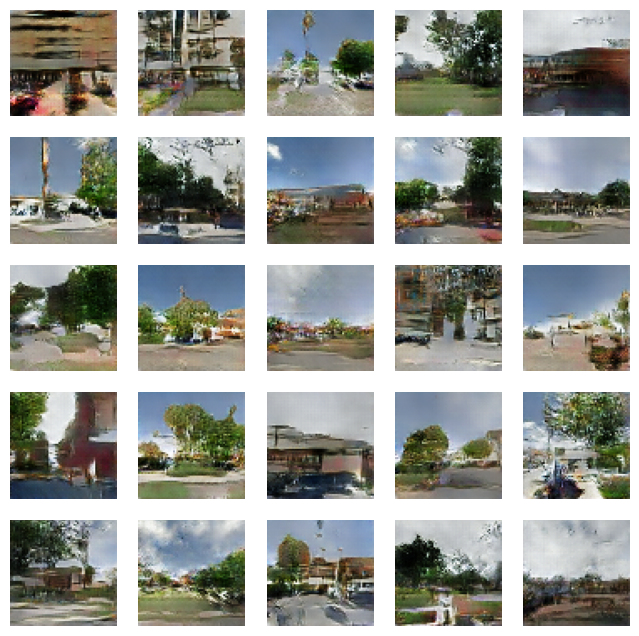

615/615 [==============================] - 42s 68ms/step - d_loss: 0.6655 - g_loss: 0.9608 - d_accuracy: 0.5831 - g_accuracy: 0.1264
Epoch 39/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6597 - g_loss: 0.9789 - d_accuracy: 0.5977 - g_accuracy: 0.1209

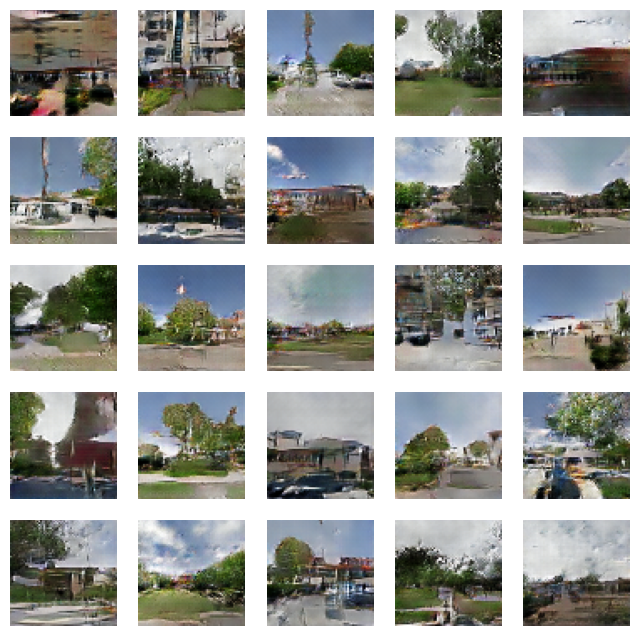

615/615 [==============================] - 42s 69ms/step - d_loss: 0.6598 - g_loss: 0.9788 - d_accuracy: 0.5976 - g_accuracy: 0.1210
Epoch 40/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6581 - g_loss: 0.9880 - d_accuracy: 0.5990 - g_accuracy: 0.1247

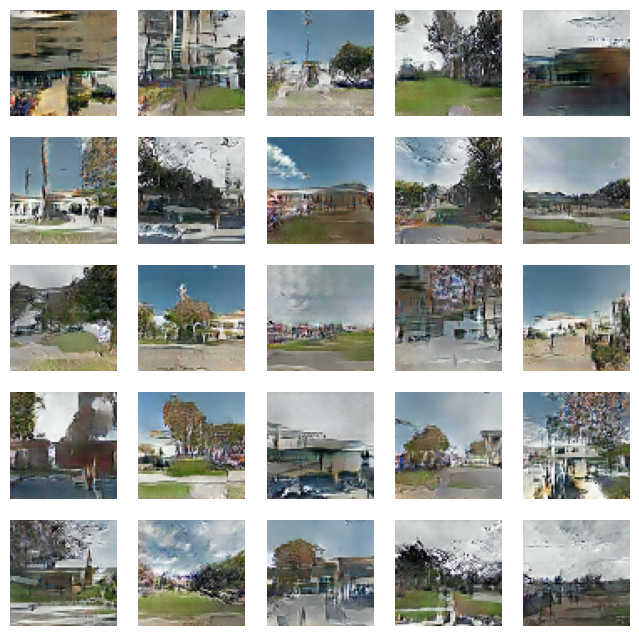

615/615 [==============================] - 42s 68ms/step - d_loss: 0.6584 - g_loss: 0.9878 - d_accuracy: 0.5989 - g_accuracy: 0.1247
Epoch 41/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6543 - g_loss: 1.0067 - d_accuracy: 0.6033 - g_accuracy: 0.1228

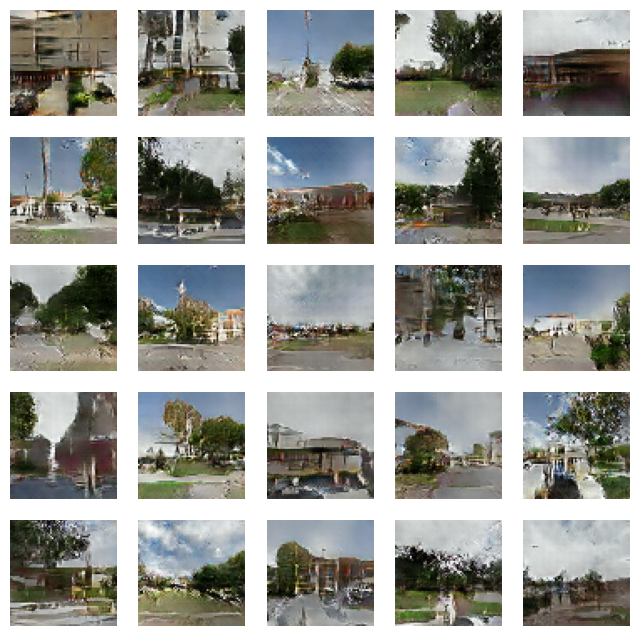

615/615 [==============================] - 42s 69ms/step - d_loss: 0.6544 - g_loss: 1.0071 - d_accuracy: 0.6032 - g_accuracy: 0.1227
Epoch 42/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6512 - g_loss: 1.0127 - d_accuracy: 0.6125 - g_accuracy: 0.1252

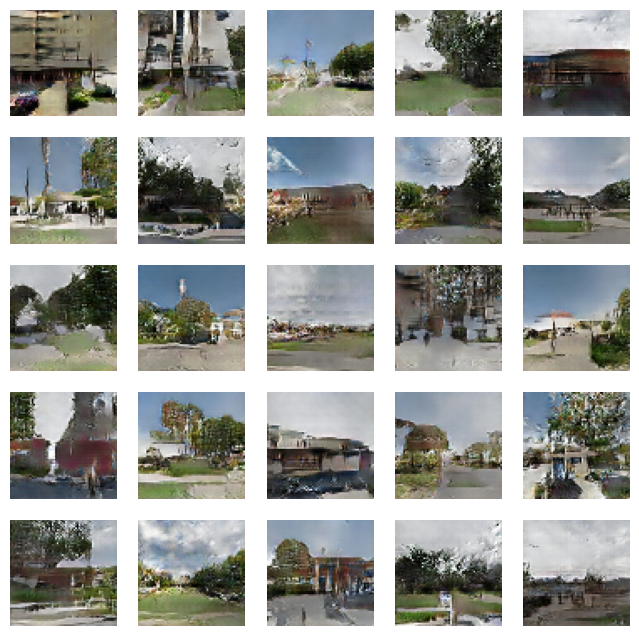

615/615 [==============================] - 42s 69ms/step - d_loss: 0.6513 - g_loss: 1.0127 - d_accuracy: 0.6124 - g_accuracy: 0.1252
Epoch 43/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6514 - g_loss: 1.0201 - d_accuracy: 0.6106 - g_accuracy: 0.1291

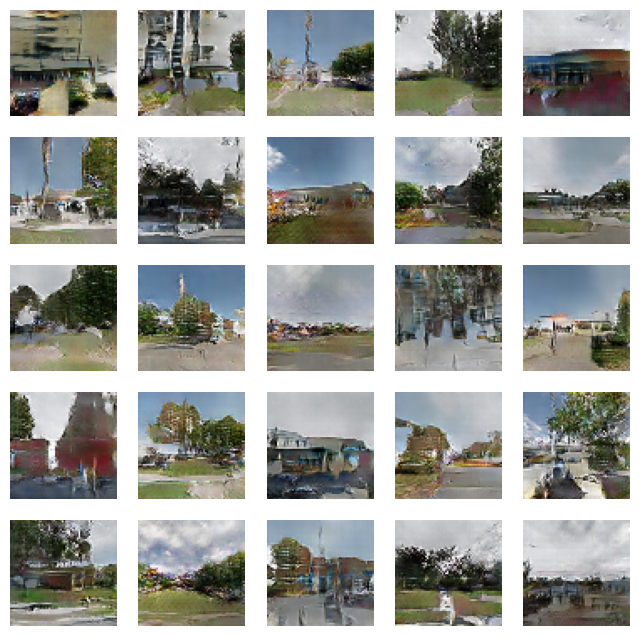

615/615 [==============================] - 42s 68ms/step - d_loss: 0.6514 - g_loss: 1.0201 - d_accuracy: 0.6106 - g_accuracy: 0.1292
Epoch 44/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6474 - g_loss: 1.0325 - d_accuracy: 0.6148 - g_accuracy: 0.1291

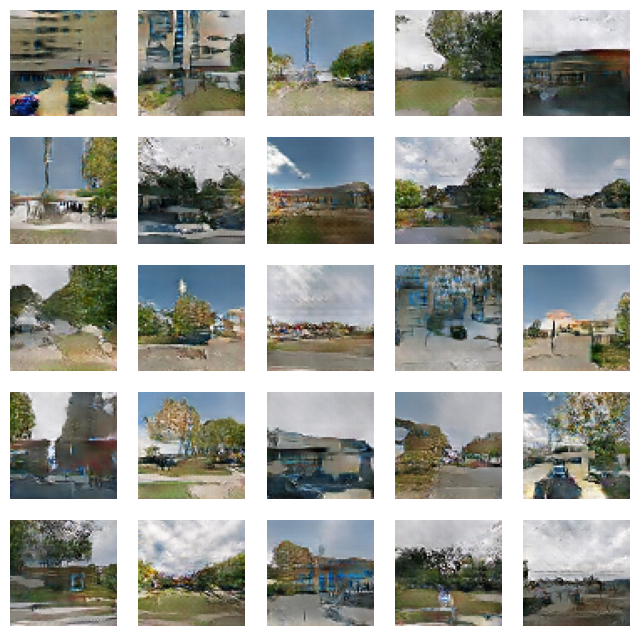

615/615 [==============================] - 42s 68ms/step - d_loss: 0.6474 - g_loss: 1.0330 - d_accuracy: 0.6148 - g_accuracy: 0.1290
Epoch 45/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6420 - g_loss: 1.0579 - d_accuracy: 0.6261 - g_accuracy: 0.1213

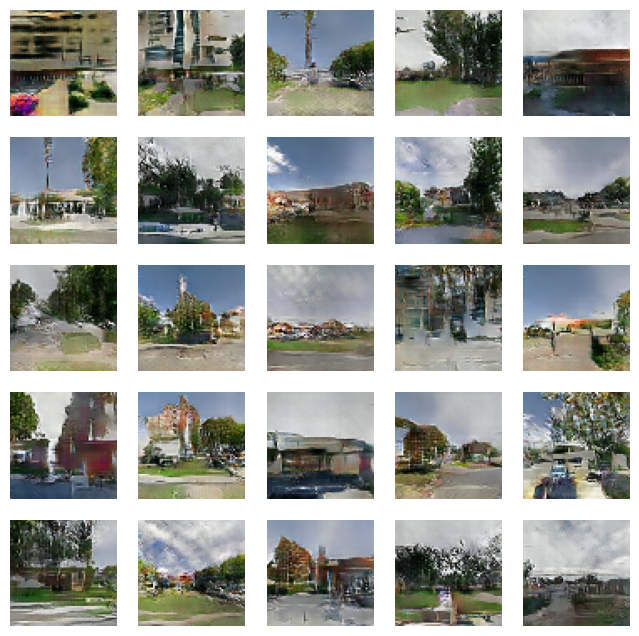

615/615 [==============================] - 42s 69ms/step - d_loss: 0.6420 - g_loss: 1.0578 - d_accuracy: 0.6261 - g_accuracy: 0.1213
Epoch 46/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6394 - g_loss: 1.0586 - d_accuracy: 0.6307 - g_accuracy: 0.1269

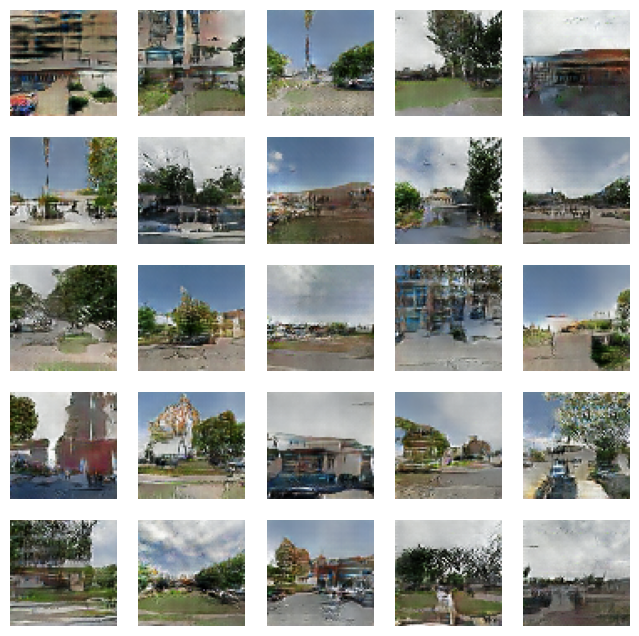

615/615 [==============================] - 42s 69ms/step - d_loss: 0.6393 - g_loss: 1.0589 - d_accuracy: 0.6307 - g_accuracy: 0.1269
Epoch 47/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6391 - g_loss: 1.0839 - d_accuracy: 0.6330 - g_accuracy: 0.1227

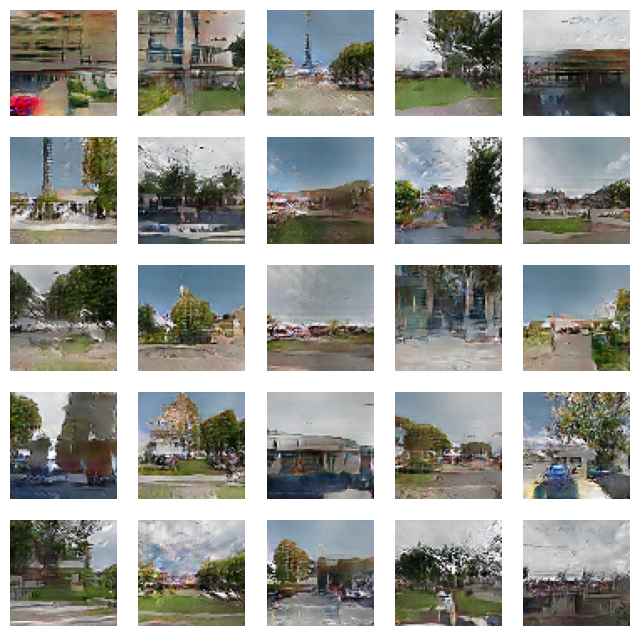

615/615 [==============================] - 42s 68ms/step - d_loss: 0.6390 - g_loss: 1.0842 - d_accuracy: 0.6331 - g_accuracy: 0.1226
Epoch 48/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6337 - g_loss: 1.0903 - d_accuracy: 0.6388 - g_accuracy: 0.1270

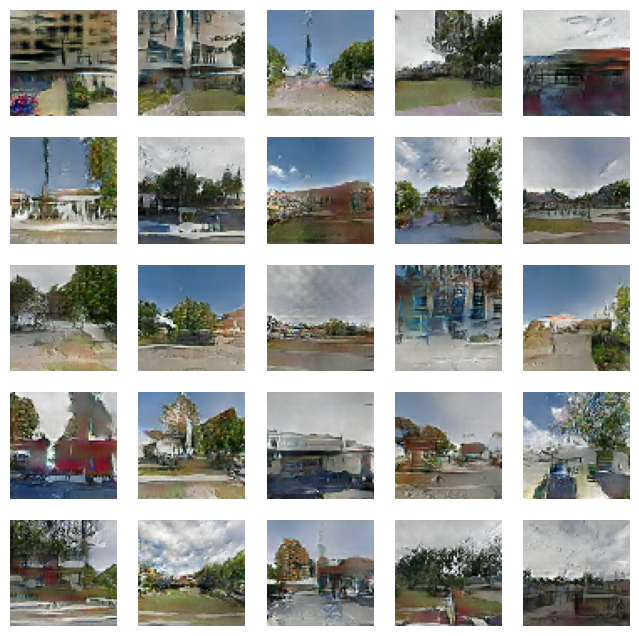

615/615 [==============================] - 42s 69ms/step - d_loss: 0.6337 - g_loss: 1.0903 - d_accuracy: 0.6388 - g_accuracy: 0.1270
Epoch 49/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6305 - g_loss: 1.0998 - d_accuracy: 0.6473 - g_accuracy: 0.1238

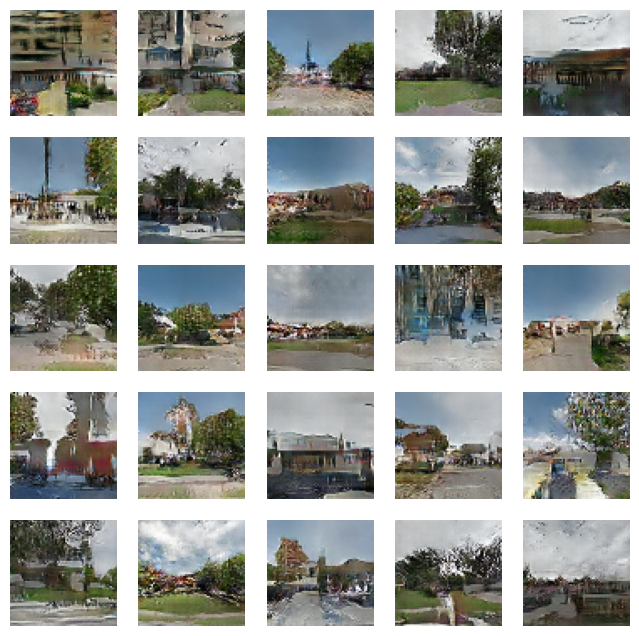

615/615 [==============================] - 42s 68ms/step - d_loss: 0.6306 - g_loss: 1.0994 - d_accuracy: 0.6472 - g_accuracy: 0.1240
Epoch 50/50
614/615 [============================>.] - ETA: 0s - d_loss: 0.6261 - g_loss: 1.1282 - d_accuracy: 0.6495 - g_accuracy: 0.1202

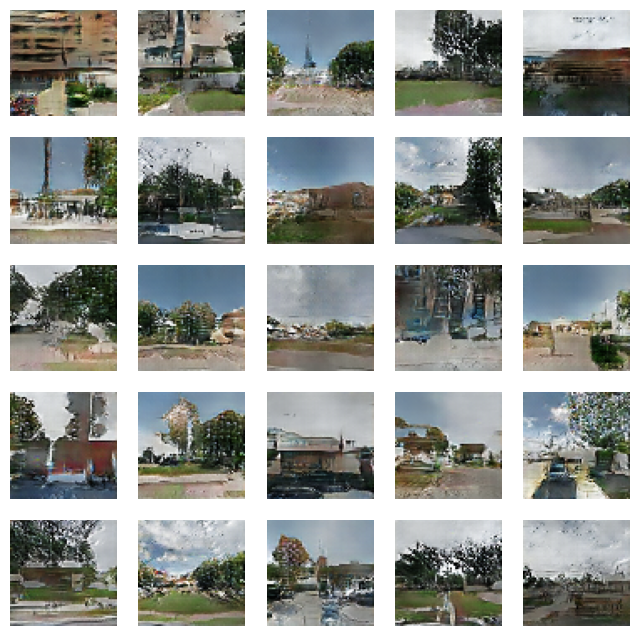

615/615 [==============================] - 42s 68ms/step - d_loss: 0.6261 - g_loss: 1.1282 - d_accuracy: 0.6495 - g_accuracy: 0.1203


In [23]:
# train the model
N_EPOCHS = 50
history = dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

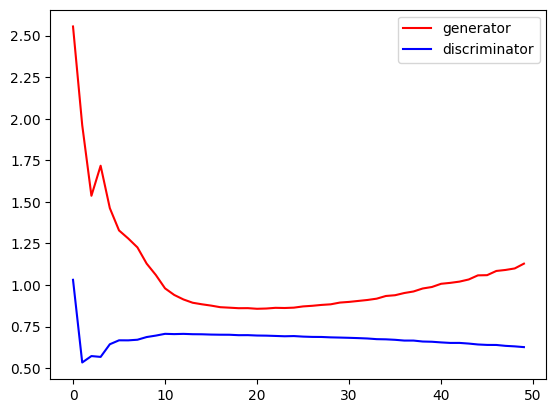

In [30]:
import matplotlib.pyplot as plt

plt.plot(history.history['g_loss'],color='red',label='generator')
plt.plot(history.history['d_loss'],color='blue',label='discriminator')
plt.legend()
plt.show()

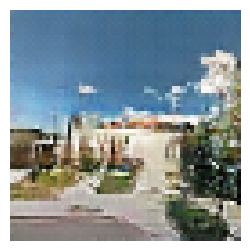

In [32]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(3, 3))
# generate the image from noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
plt.show()

In [33]:
!zip -r /content/street_image_outputs.zip /content/drive/MyDrive/outputs

updating: content/drive/MyDrive/outputs/ (stored 0%)
updating: content/drive/MyDrive/outputs/epoch_008.png (deflated 1%)
updating: content/drive/MyDrive/outputs/epoch_025.png (deflated 1%)
updating: content/drive/MyDrive/outputs/epoch_030.png (deflated 1%)
updating: content/drive/MyDrive/outputs/epoch_032.png (deflated 1%)
updating: content/drive/MyDrive/outputs/epoch_045.png (deflated 1%)
updating: content/drive/MyDrive/outputs/epoch_011.png (deflated 1%)
updating: content/drive/MyDrive/outputs/epoch_034.png (deflated 1%)
updating: content/drive/MyDrive/outputs/epoch_016.png (deflated 1%)
updating: content/drive/MyDrive/outputs/epoch_046.png (deflated 1%)
updating: content/drive/MyDrive/outputs/epoch_037.png (deflated 1%)
updating: content/drive/MyDrive/outputs/epoch_042.png (deflated 1%)
updating: content/drive/MyDrive/outputs/epoch_022.png (deflated 1%)
updating: content/drive/MyDrive/outputs/epoch_001.png (deflated 0%)
updating: content/drive/MyDrive/outputs/epoch_044.png (deflated